In [1]:
import pathlib
#bibliotecas
import sys

import pandas as pd
from IPython.core.display import display

import utilities as util

pd.options.mode.chained_assignment = None
from scipy.stats import chisquare

/tmp/ipykernel_7335/765542168.py:6: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


## LIBRERIA

### Importación de librería personal

In [2]:
sys.path.append(pathlib.Path().parent.absolute())
#Importando módulo con funciones a utilizar
from funciones import *

## Lectura de dataset

In [3]:
#Lectura de datos
import glob

path = 'ecobici/viajes/*.csv'

dfStations = pd.read_csv("ecobici/estaciones/estaciones.csv")

dfTrips = pd.concat(map(pd.read_csv, glob.glob(path)))
dfTrips.rename(columns={'Ciclo_EstacionArribo':'Ciclo_Estacion_Arribo','Fecha Arribo': 'Fecha_Arribo','Hora Arribo':'Hora_Arribo'}, inplace = True)


# Etiquetado variables

In [4]:
 #continuas
station_c_feats = ['id','zipcode','altitude',
           'nearbystations_0','location_lat','location_lon',
           'nearbystations_1','nearbystations_2','nearbystations_3',
           'nearbystations_4','nearbystations_5']

trip_c_feats = ['Edad_Usuario','Bici','Ciclo_Estacion_Retiro',
                'Ciclo_Estacion_Arribo']

 #categóricas
station_v_feats = ['stationtype','districtname','districtcode']

trip_v_feats = ['Genero_Usuario']

 #Date
trip_d_feats = ['Fecha_Retiro','Hora_Retiro','Fecha_Arribo','Hora_Arribo']

 #Text
station_t_feats =['name','address','addressnumber','punto_geo']


#Re-etiquetando columnas
reEtiquetaVars(dfStations,'c',station_c_feats)
reEtiquetaVars(dfStations,'v',station_v_feats)
reEtiquetaVars(dfStations,'t',station_t_feats)

reEtiquetaVars(dfTrips,'c',trip_c_feats)
reEtiquetaVars(dfTrips,'v',trip_v_feats)
reEtiquetaVars(dfTrips,'d',trip_d_feats)

# Completitud

In [5]:
completitud(dfStations)

,columna,total,completitud
0,c_altitude,480,0.000000
1,c_nearbystations_4,477,0.625000
2,c_nearbystations_5,477,0.625000
3,c_nearbystations_3,444,7.500000
4,c_zipcode,149,68.958333
5,c_nearbystations_2,59,87.708333
6,c_nearbystations_1,17,96.458333
7,v_districtcode,1,99.791667
8,v_districtname,1,99.791667
9,c_id,0,100.000000


In [6]:
#ELiminamos columnas con missings mayor al 30%
dfStations =  dfStations.drop(columns=['c_altitude','c_nearbystations_4','c_nearbystations_5',
                       'c_nearbystations_3'])

In [7]:
completitud(dfTrips)

,columna,total,completitud
0,v_genero_usuario,120,99.994201
1,c_edad_usuario,120,99.994201
2,c_bici,0,100.000000
3,c_ciclo_estacion_retiro,0,100.000000
4,d_fecha_retiro,0,100.000000
5,d_hora_retiro,0,100.000000
6,c_ciclo_estacion_arribo,0,100.000000
7,d_fecha_arribo,0,100.000000
8,d_hora_arribo,0,100.000000


In [8]:
dfTrips = dfTrips.dropna()

## Consistencia

**Estaciones**

In [9]:
dfStations.dtypes

c_id                    int64
t_name                 object
t_address              object
t_addressnumber        object
c_zipcode             float64
v_districtcode         object
v_districtname         object
c_nearbystations_0      int64
c_location_lat        float64
c_location_lon        float64
v_stationtype          object
c_nearbystations_1    float64
c_nearbystations_2    float64
t_punto_geo            object
dtype: object

In [10]:
# valores de latitud
dfStations[dfStations["c_location_lat"].map(lambda x:x<=-90 or x>=90)].shape

(0, 14)

In [11]:
# valores de longitud
dfStations[dfStations["c_location_lon"].map(lambda x:x<=-180 or x>=180)].shape

(0, 14)

In [12]:
dfStations.describe()

,c_id,c_zipcode,c_nearbystations_0,c_location_lat,c_location_lon,c_nearbystations_1,c_nearbystations_2
count,480.000000,331.00000,480.000000,480.000000,480.000000,463.000000,421.000000
mean,240.500000,5621.23565,223.525000,19.409647,-99.170918,236.028078,255.000000
std,138.708327,2837.40564,137.106223,0.024425,0.015825,136.424064,135.737509
min,1.000000,3020.00000,1.000000,19.358270,-99.212845,3.000000,5.000000
25%,120.750000,3235.00000,106.250000,19.388946,-99.179836,118.000000,143.000000
50%,240.500000,3920.00000,206.500000,19.414846,-99.171091,235.000000,256.000000
75%,360.250000,6500.00000,341.250000,19.430649,-99.160599,357.500000,371.000000
max,480.000000,11800.00000,476.000000,19.446073,-99.130918,477.000000,479.000000


In [13]:
#t_addressnumber solo contiene un valor(s/n)
dfStations = dfStations.drop(columns=['t_addressnumber'])

**Viajes**

In [14]:
dfStations.v_districtname = dfStations.v_districtname.fillna("Cuauhtémoc")
dfStations.v_districtcode = dfStations.v_districtcode.fillna("CUA")

In [15]:
# valores de edad
dfTrips[dfTrips["c_edad_usuario"].map(lambda x:x<=0 or x>=100)].shape

(2, 9)

In [16]:
#Eliminar registros con edad inconsistente
dfTrips = dfTrips[~dfTrips["c_edad_usuario"].map(lambda x:x<=0 or x>=100)]
dfTrips.reset_index(drop=True,inplace=True)

In [17]:
dfTrips

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo
0,M,19.0,6177539,421,31/01/2023,23:27:12.7310,414,01/02/2023,00:00:42.1810
1,F,26.0,5337753,005,31/01/2023,23:37:16.1320,260,01/02/2023,00:00:42.3760
2,F,28.0,2099497,397,31/01/2023,23:56:41.6150,374,01/02/2023,00:00:52.7020
3,M,33.0,2964914,320,31/01/2023,23:53:42.0760,165,01/02/2023,00:01:01.4630
4,F,24.0,2231769,260,31/01/2023,23:35:46.9780,123,01/02/2023,00:01:31.3700
...,...,...,...,...,...,...,...,...,...
2069322,M,36.0,8294035,140,31/03/2023,23:33:08.9640,423,31/03/2023,23:59:38.4770
2069323,M,34.0,3085263,229,31/03/2023,23:58:07.3650,235-236,31/03/2023,23:59:42.8130
2069324,M,34.0,4418810,399,31/03/2023,23:26:39.8210,251,31/03/2023,23:59:49.1730
2069325,M,23.0,3590841,030,31/03/2023,23:47:50.9150,551,31/03/2023,23:59:53.5930


In [17]:
#Las columnas vienen con numeros del estilo 245-246, nos quedamos con el primero
# Convertir la columna a una cadena de caracteres
dfTrips['c_ciclo_estacion_retiro'] = dfTrips['c_ciclo_estacion_retiro'].astype(str)
dfTrips['c_ciclo_estacion_arribo'] = dfTrips['c_ciclo_estacion_arribo'].astype(str)

# Dividir la cadena en dos partes en función del guión solo para los valores que lo contienen
# Verificar si la cadena contiene un número antes de convertirla en un entero
dfTrips['c_ciclo_estacion_arribo'] = dfTrips['c_ciclo_estacion_arribo'].apply(lambda x: int(x.split('-')[0]) if ('-' in x) and (x.split('-')[0].isdigit()) else int(x) if(x.isdigit()) else -1)
dfTrips['c_ciclo_estacion_retiro'] = dfTrips['c_ciclo_estacion_retiro'].apply(lambda x: int(x.split('-')[0]) if ('-' in x) and (x.split('-')[0].isdigit()) else int(x) if(x.isdigit()) else -1)


In [18]:
dfTrips['c_ciclo_estacion_arribo'] = dfTrips['c_ciclo_estacion_arribo'].astype('Int64')

In [19]:
#Establecemos formatos y tipos de datos
dfTrips['c_edad_usuario'] = dfTrips['c_edad_usuario'].astype('Int64')
dfTrips['c_bici'] = dfTrips['c_bici'].astype('Int64')
dfTrips['c_ciclo_estacion_retiro'] = dfTrips['c_ciclo_estacion_retiro'].astype('Int64')
dfTrips['d_fecha_retiro'] = pd.to_datetime(dfTrips['d_fecha_retiro'])
dfTrips['c_ciclo_estacion_arribo'] = dfTrips['c_ciclo_estacion_arribo'].astype('Int64')
dfTrips['d_fecha_arribo'] = pd.to_datetime(dfTrips['d_fecha_arribo'])

/tmp/ipykernel_7335/3942025470.py:5: UserWarning:

Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.

/tmp/ipykernel_7335/3942025470.py:7: UserWarning:

Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.



In [21]:
dfTrips

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo
0,M,19,6177539,421,2023-01-31,23:27:12.7310,414,2023-01-02,00:00:42.1810
1,F,26,5337753,5,2023-01-31,23:37:16.1320,260,2023-01-02,00:00:42.3760
2,F,28,2099497,397,2023-01-31,23:56:41.6150,374,2023-01-02,00:00:52.7020
3,M,33,2964914,320,2023-01-31,23:53:42.0760,165,2023-01-02,00:01:01.4630
4,F,24,2231769,260,2023-01-31,23:35:46.9780,123,2023-01-02,00:01:31.3700
...,...,...,...,...,...,...,...,...,...
2069322,M,36,8294035,140,2023-03-31,23:33:08.9640,423,2023-03-31,23:59:38.4770
2069323,M,34,3085263,229,2023-03-31,23:58:07.3650,235,2023-03-31,23:59:42.8130
2069324,M,34,4418810,399,2023-03-31,23:26:39.8210,251,2023-03-31,23:59:49.1730
2069325,M,23,3590841,30,2023-03-31,23:47:50.9150,551,2023-03-31,23:59:53.5930


In [20]:
switcher ={
        0 : "Lunes",
        1 : "Martes",
        2 :"Miercoles",
        3 :"Jueves",
        4 :"Viernes",
        5 :"Sabado",
        6 :"Domingo"
    }
dfTrips['v_day_week_retiro']  = list(map(lambda day_week : switcher.get(day_week.weekday(), "otro"),dfTrips.d_fecha_retiro))
dfTrips['v_day_week_arribo']  = list(map(lambda day_week : switcher.get(day_week.weekday(), "otro"),dfTrips.d_fecha_arribo))


# Normalizacion

In [21]:
dfTrips.v_genero_usuario.value_counts()

M    1466329
F     547537
O      55452
?          9
Name: v_genero_usuario, dtype: int64

In [22]:
dfTrips['v_genero_usuario'] = dfTrips['v_genero_usuario'].apply(lambda x: "otro" if (x=='O') or (x=='?') else x)

# Analisis Exploratorio de Datos 

 **Distribución de estaciones por tipo**

In [23]:
graph_pie_count(dfStations,'v_stationtype','Tipos')

 **Distribución de estaciones por distrito**

In [24]:
graph_pie_count(dfStations,'v_districtname','Generacion')

 **Distribución de usuarios por género**

In [26]:
graph_pie_count(dfTrips,'v_genero_usuario','status')

In [27]:
dfTrips['c_edad_usuario'] = dfTrips['c_edad_usuario'].astype('float')

 **Histograma de edades de los usuarios**

In [28]:
dfTrips.c_edad_usuario.value_counts()

30.0    113671
31.0    110378
28.0    109000
29.0    105523
33.0    103262
         ...  
82.0        39
83.0        33
87.0        22
79.0        16
88.0         4
Name: c_edad_usuario, Length: 70, dtype: int64

In [29]:
graph_histogram(dfTrips,'c_edad_usuario',100,'TTitle','','')

# Outliers

**Estaciones**

In [30]:
#Bucando outliers
feats=list(dfStations.filter(like="c_").columns)
outliers=search_outliers(dfStations,feats)
outliers

,features,n_outliers_IQR,n_outliers_Percentil,n_outliers_Z_Score,n_outliers_IQR_%,n_outliers_Percentil_%,n_outliers_Z_Score_%,total_outliers,%_outliers,indices
0,c_id,0,48,0,0.00,10.00,0.0,0,0.00,[]
1,c_zipcode,49,19,0,10.21,3.96,0.0,0,0.00,[]
2,c_nearbystations_0,0,48,0,0.00,10.00,0.0,0,0.00,[]
3,c_location_lat,0,47,0,0.00,9.79,0.0,0,0.00,[]
4,c_location_lon,4,48,0,0.83,10.00,0.0,0,0.00,[]
5,c_nearbystations_1,0,48,0,0.00,10.00,0.0,4,0.83,"[72, 246, 470, 367]"
6,c_nearbystations_2,0,41,0,0.00,8.54,0.0,4,0.83,"[313, 157, 398, 377]"


In [33]:
dfStations.shape

(480, 13)

In [31]:
#Eliminación outlier stations
indices=list(outliers[outliers["features"]=="c_nearbystations_1"]["indices"].values)[0]
indices.extend(list(outliers[outliers["features"]=="c_nearbystations_2"]["indices"].values)[0])
dfStations = dfStations[~dfStations.index.isin(indices)]
dfStations.shape

(472, 13)

In [32]:
dfTrips['c_edad_usuario'] = dfTrips['c_edad_usuario'].astype('float')
dfTrips['c_bici'] = dfTrips['c_bici'].astype('float')
dfTrips['c_ciclo_estacion_retiro'] = dfTrips['c_ciclo_estacion_retiro'].astype('float')
dfTrips['c_ciclo_estacion_arribo'] = dfTrips['c_ciclo_estacion_arribo'].astype('float')

**Viajes**

In [33]:
#Bucando outliers
feats=list(dfTrips.filter(like="c_").columns)
outliers=search_outliers(dfTrips,feats)
outliers

,features,n_outliers_IQR,n_outliers_Percentil,n_outliers_Z_Score,n_outliers_IQR_%,n_outliers_Percentil_%,n_outliers_Z_Score_%,total_outliers,%_outliers,indices
0,c_edad_usuario,65109,173065,22363,3.15,8.36,1.08,0,0.00,[]
1,c_bici,0,206141,0,0.00,9.96,0.00,9073,0.44,"[360449, 1441793, 425991, 1867789, 1540115, 29..."
2,c_ciclo_estacion_retiro,9073,196036,9073,0.44,9.47,0.44,65109,3.15,"[1441796, 786437, 917511, 655368, 1835015, 917..."
3,c_ciclo_estacion_arribo,9167,194871,9167,0.44,9.42,0.44,9167,0.44,"[1736707, 1736708, 425991, 229384, 2064394, 18..."


In [37]:
dfTrips.shape

(2069327, 11)

In [34]:
# ELiminación outliers Trips
indices=list(outliers[outliers["features"]=="c_ciclo_estacion_retiro"]["indices"].values)[0]
indices.extend(list(outliers[outliers["features"]=="c_ciclo_estacion_arribo"]["indices"].values)[0])
dfTrips = dfTrips[~dfTrips.index.isin(indices)]
dfTrips.shape

(1995433, 11)

# Imputar valores estaciones

In [35]:
completitud(dfStations)

,columna,total,completitud
0,c_zipcode,146,69.067797
1,c_nearbystations_2,58,87.711864
2,c_nearbystations_1,16,96.610169
3,c_id,0,100.000000
4,t_name,0,100.000000
5,t_address,0,100.000000
6,v_districtcode,0,100.000000
7,v_districtname,0,100.000000
8,c_nearbystations_0,0,100.000000
9,c_location_lat,0,100.000000


In [36]:
dfStations.c_zipcode = dfStations.c_zipcode.fillna(0)
dfStations.c_nearbystations_0 =dfStations.c_nearbystations_0.fillna(0)
dfStations.c_nearbystations_1= dfStations.c_nearbystations_1.fillna(0)
dfStations.c_nearbystations_2 = dfStations.c_nearbystations_2.fillna(0)

In [37]:
completitud(dfStations)

,columna,total,completitud
0,c_id,0,100.0
1,t_name,0,100.0
2,t_address,0,100.0
3,c_zipcode,0,100.0
4,v_districtcode,0,100.0
5,v_districtname,0,100.0
6,c_nearbystations_0,0,100.0
7,c_location_lat,0,100.0
8,c_location_lon,0,100.0
9,v_stationtype,0,100.0


# Ingenieria de variables

In [38]:
# Agregar variable que especifique en que momento del día se 
# realizó el viaje (Madrugada,Dia,Tarde,Noche)

dfTrips['d_hora_retiro_2'] = pd.to_datetime(dfTrips['d_hora_retiro']).dt.hour
dfTrips['v_moment_of_day'] = dfTrips['d_hora_retiro_2'].map(lambda x: 'madrugada' if (x>=0.0 and x<6.0) else 'dia' if (x>=6.0 and x<12.0) else 'tarde' if (x>=12.0 and x<18.0) else 'noche')
dfTrips = dfTrips.drop(columns='d_hora_retiro_2')

In [39]:
dfTrips

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day
0,M,19.0,6177539.0,421.0,2023-01-31,23:27:12.7310,414.0,2023-01-02,00:00:42.1810,Martes,Lunes,noche
1,F,26.0,5337753.0,5.0,2023-01-31,23:37:16.1320,260.0,2023-01-02,00:00:42.3760,Martes,Lunes,noche
2,F,28.0,2099497.0,397.0,2023-01-31,23:56:41.6150,374.0,2023-01-02,00:00:52.7020,Martes,Lunes,noche
3,M,33.0,2964914.0,320.0,2023-01-31,23:53:42.0760,165.0,2023-01-02,00:01:01.4630,Martes,Lunes,noche
4,F,24.0,2231769.0,260.0,2023-01-31,23:35:46.9780,123.0,2023-01-02,00:01:31.3700,Martes,Lunes,noche
...,...,...,...,...,...,...,...,...,...,...,...,...
2069322,M,36.0,8294035.0,140.0,2023-03-31,23:33:08.9640,423.0,2023-03-31,23:59:38.4770,Viernes,Viernes,noche
2069323,M,34.0,3085263.0,229.0,2023-03-31,23:58:07.3650,235.0,2023-03-31,23:59:42.8130,Viernes,Viernes,noche
2069324,M,34.0,4418810.0,399.0,2023-03-31,23:26:39.8210,251.0,2023-03-31,23:59:49.1730,Viernes,Viernes,noche
2069325,M,23.0,3590841.0,30.0,2023-03-31,23:47:50.9150,551.0,2023-03-31,23:59:53.5930,Viernes,Viernes,noche


In [40]:
dfStations

,c_id,t_name,t_address,c_zipcode,v_districtcode,v_districtname,c_nearbystations_0,c_location_lat,c_location_lon,v_stationtype,c_nearbystations_1,c_nearbystations_2,t_punto_geo
0,86,86 SULLIVAN-INSURGENTES,086 - Sullivan-Insurgentes,6470.0,1,Ampliación Granada,12,19.432378,-99.159077,"BIKE,TPV",20.0,0.0,"19.432378,-99.159077"
1,250,250 DARWIN-MARIANO ESCOBEDO,250 - Darwin-Mariano Escobedo,11510.0,1,Ampliación Granada,239,19.429057,-99.179660,"BIKE,TPV",249.0,252.0,"19.429057,-99.17966"
2,273,273 LUIS DONALDO COLOSIO-AV. CENTRAL,273 Luis Donaldo Colosio - Av. Jesus Garcia,0.0,1,Ampliación Granada,176,19.442707,-99.152956,BIKE,268.0,274.0,"19.442707,-99.152956"
3,278,278 MIER Y PESADO-OBRERO MUNDIAL,278 - Mier Y Pesado-Obrero Mundial,3103.0,1,Ampliación Granada,164,19.400710,-99.163831,BIKE,279.0,282.0,"19.40071,-99.163831"
4,305,305 AVENIDA DEL PARQUE-ARIZONA,305 - Avenida Del Parque-Arizona,3810.0,1,Ampliación Granada,304,19.394693,-99.175531,"BIKE,TPV",306.0,307.0,"19.394693,-99.175531"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,156,156 TEPIC-AMENALCO,156 - Tepic-Amenalco,0.0,ROM,Roma Sur,153,19.407121,-99.162202,BIKE,155.0,162.0,"19.407121,-99.162202"
476,162,162 TEHUANTEPEC-MEDELLÍN,162 - Tehuantepec-Medellín,0.0,ROM,Roma Sur,161,19.404907,-99.162485,BIKE,165.0,0.0,"19.404907,-99.162485"
477,410,410 PROLONGACIÓN TAJÍN-PROLONGACIÓN REPÚBLICAS,410 - Prolongación Tajín-Prolongación Repúblicas,3310.0,SCA,Santa Cruz Atoyac,407,19.365640,-99.158063,BIKE,408.0,409.0,"19.36564,-99.158063"
478,411,411 PARROQUIA-AVENIDA MÉXICO-COYOACAN,411 - Parroquia-Avenida México-Coyoacan,3310.0,SCA,Santa Cruz Atoyac,412,19.367864,-99.163626,BIKE,425.0,427.0,"19.367864,-99.163626"


In [41]:
# limpieza variables de texto para  retirar el id y tener solo el nombre y la dirección de la estación

dfStations["t_name"] = dfStations.apply(lambda a: a["t_name"].replace(str(a.c_id), ""), axis=1)
dfStations["t_address"] = dfStations.apply(lambda a: a["t_address"].replace(str(a.c_id)+" -", ""), axis=1)
dfStations["t_address"] = dfStations.apply(lambda a: a["t_address"].replace(str(a.c_id), ""), axis=1)
dfStations["t_address"] = dfStations.apply(lambda a: a["t_address"].replace("0", ""), axis=1)
dfStations["t_address"] = dfStations.apply(lambda a: a["t_address"].replace(" - ", ""), axis=1)

In [46]:
dfStations

,c_id,t_name,t_address,c_zipcode,v_districtcode,v_districtname,c_nearbystations_0,c_location_lat,c_location_lon,v_stationtype,c_nearbystations_1,c_nearbystations_2,t_punto_geo
0,86,SULLIVAN-INSURGENTES,Sullivan-Insurgentes,6470.0,1,Ampliación Granada,12,19.432378,-99.159077,"BIKE,TPV",20.0,0.0,"19.432378,-99.159077"
1,250,DARWIN-MARIANO ESCOBEDO,Darwin-Mariano Escobedo,11510.0,1,Ampliación Granada,239,19.429057,-99.179660,"BIKE,TPV",249.0,252.0,"19.429057,-99.17966"
2,273,LUIS DONALDO COLOSIO-AV. CENTRAL,Luis Donaldo ColosioAv. Jesus Garcia,0.0,1,Ampliación Granada,176,19.442707,-99.152956,BIKE,268.0,274.0,"19.442707,-99.152956"
3,278,MIER Y PESADO-OBRERO MUNDIAL,Mier Y Pesado-Obrero Mundial,3103.0,1,Ampliación Granada,164,19.400710,-99.163831,BIKE,279.0,282.0,"19.40071,-99.163831"
4,305,AVENIDA DEL PARQUE-ARIZONA,Avenida Del Parque-Arizona,3810.0,1,Ampliación Granada,304,19.394693,-99.175531,"BIKE,TPV",306.0,307.0,"19.394693,-99.175531"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,156,TEPIC-AMENALCO,Tepic-Amenalco,0.0,ROM,Roma Sur,153,19.407121,-99.162202,BIKE,155.0,162.0,"19.407121,-99.162202"
476,162,TEHUANTEPEC-MEDELLÍN,Tehuantepec-Medellín,0.0,ROM,Roma Sur,161,19.404907,-99.162485,BIKE,165.0,0.0,"19.404907,-99.162485"
477,410,PROLONGACIÓN TAJÍN-PROLONGACIÓN REPÚBLICAS,Prolongación Tajín-Prolongación Repúblicas,3310.0,SCA,Santa Cruz Atoyac,407,19.365640,-99.158063,BIKE,408.0,409.0,"19.36564,-99.158063"
478,411,PARROQUIA-AVENIDA MÉXICO-COYOACAN,Parroquia-Avenida México-Coyoacan,3310.0,SCA,Santa Cruz Atoyac,412,19.367864,-99.163626,BIKE,425.0,427.0,"19.367864,-99.163626"


In [47]:
dfTrips

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day
0,M,19.0,6177539.0,421.0,2023-01-31,23:27:12.7310,414.0,2023-01-02,00:00:42.1810,Martes,Lunes,noche
1,F,26.0,5337753.0,5.0,2023-01-31,23:37:16.1320,260.0,2023-01-02,00:00:42.3760,Martes,Lunes,noche
2,F,28.0,2099497.0,397.0,2023-01-31,23:56:41.6150,374.0,2023-01-02,00:00:52.7020,Martes,Lunes,noche
3,M,33.0,2964914.0,320.0,2023-01-31,23:53:42.0760,165.0,2023-01-02,00:01:01.4630,Martes,Lunes,noche
4,F,24.0,2231769.0,260.0,2023-01-31,23:35:46.9780,123.0,2023-01-02,00:01:31.3700,Martes,Lunes,noche
...,...,...,...,...,...,...,...,...,...,...,...,...
2069322,M,36.0,8294035.0,140.0,2023-03-31,23:33:08.9640,423.0,2023-03-31,23:59:38.4770,Viernes,Viernes,noche
2069323,M,34.0,3085263.0,229.0,2023-03-31,23:58:07.3650,235.0,2023-03-31,23:59:42.8130,Viernes,Viernes,noche
2069324,M,34.0,4418810.0,399.0,2023-03-31,23:26:39.8210,251.0,2023-03-31,23:59:49.1730,Viernes,Viernes,noche
2069325,M,23.0,3590841.0,30.0,2023-03-31,23:47:50.9150,551.0,2023-03-31,23:59:53.5930,Viernes,Viernes,noche


In [42]:
dfTrips.c_ciclo_estacion_retiro = dfTrips.c_ciclo_estacion_retiro.fillna(0)
dfTrips.c_ciclo_estacion_arribo = dfTrips.c_ciclo_estacion_arribo.fillna(0)
dfTrips.c_ciclo_estacion_retiro = list(map(lambda eco :int(eco),dfTrips.c_ciclo_estacion_retiro))
dfTrips.c_ciclo_estacion_arribo = list(map(lambda eco :int(eco),dfTrips.c_ciclo_estacion_arribo))

In [49]:
dfTrips.head()

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day
0,M,19.0,6177539.0,421,2023-01-31,23:27:12.7310,414,2023-01-02,00:00:42.1810,Martes,Lunes,noche
1,F,26.0,5337753.0,5,2023-01-31,23:37:16.1320,260,2023-01-02,00:00:42.3760,Martes,Lunes,noche
2,F,28.0,2099497.0,397,2023-01-31,23:56:41.6150,374,2023-01-02,00:00:52.7020,Martes,Lunes,noche
3,M,33.0,2964914.0,320,2023-01-31,23:53:42.0760,165,2023-01-02,00:01:01.4630,Martes,Lunes,noche
4,F,24.0,2231769.0,260,2023-01-31,23:35:46.9780,123,2023-01-02,00:01:31.3700,Martes,Lunes,noche


In [50]:
dfStations.head()

,c_id,t_name,t_address,c_zipcode,v_districtcode,v_districtname,c_nearbystations_0,c_location_lat,c_location_lon,v_stationtype,c_nearbystations_1,c_nearbystations_2,t_punto_geo
0,86,SULLIVAN-INSURGENTES,Sullivan-Insurgentes,6470.0,1,Ampliación Granada,12,19.432378,-99.159077,"BIKE,TPV",20.0,0.0,"19.432378,-99.159077"
1,250,DARWIN-MARIANO ESCOBEDO,Darwin-Mariano Escobedo,11510.0,1,Ampliación Granada,239,19.429057,-99.179660,"BIKE,TPV",249.0,252.0,"19.429057,-99.17966"
2,273,LUIS DONALDO COLOSIO-AV. CENTRAL,Luis Donaldo ColosioAv. Jesus Garcia,0.0,1,Ampliación Granada,176,19.442707,-99.152956,BIKE,268.0,274.0,"19.442707,-99.152956"
3,278,MIER Y PESADO-OBRERO MUNDIAL,Mier Y Pesado-Obrero Mundial,3103.0,1,Ampliación Granada,164,19.400710,-99.163831,BIKE,279.0,282.0,"19.40071,-99.163831"
4,305,AVENIDA DEL PARQUE-ARIZONA,Avenida Del Parque-Arizona,3810.0,1,Ampliación Granada,304,19.394693,-99.175531,"BIKE,TPV",306.0,307.0,"19.394693,-99.175531"


In [43]:

estaciones_retiro_aux = dfStations.copy()
estaciones_arribo_aux = dfStations.copy()
util.renameHeaders(estaciones_retiro_aux, estaciones_retiro_aux.columns,"retiro_")
util.renameHeaders(estaciones_arribo_aux, estaciones_arribo_aux.columns,"arribo_")

,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo
0,86,SULLIVAN-INSURGENTES,Sullivan-Insurgentes,6470.0,1,Ampliación Granada,12,19.432378,-99.159077,"BIKE,TPV",20.0,0.0,"19.432378,-99.159077"
1,250,DARWIN-MARIANO ESCOBEDO,Darwin-Mariano Escobedo,11510.0,1,Ampliación Granada,239,19.429057,-99.179660,"BIKE,TPV",249.0,252.0,"19.429057,-99.17966"
2,273,LUIS DONALDO COLOSIO-AV. CENTRAL,Luis Donaldo ColosioAv. Jesus Garcia,0.0,1,Ampliación Granada,176,19.442707,-99.152956,BIKE,268.0,274.0,"19.442707,-99.152956"
3,278,MIER Y PESADO-OBRERO MUNDIAL,Mier Y Pesado-Obrero Mundial,3103.0,1,Ampliación Granada,164,19.400710,-99.163831,BIKE,279.0,282.0,"19.40071,-99.163831"
4,305,AVENIDA DEL PARQUE-ARIZONA,Avenida Del Parque-Arizona,3810.0,1,Ampliación Granada,304,19.394693,-99.175531,"BIKE,TPV",306.0,307.0,"19.394693,-99.175531"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,156,TEPIC-AMENALCO,Tepic-Amenalco,0.0,ROM,Roma Sur,153,19.407121,-99.162202,BIKE,155.0,162.0,"19.407121,-99.162202"
476,162,TEHUANTEPEC-MEDELLÍN,Tehuantepec-Medellín,0.0,ROM,Roma Sur,161,19.404907,-99.162485,BIKE,165.0,0.0,"19.404907,-99.162485"
477,410,PROLONGACIÓN TAJÍN-PROLONGACIÓN REPÚBLICAS,Prolongación Tajín-Prolongación Repúblicas,3310.0,SCA,Santa Cruz Atoyac,407,19.365640,-99.158063,BIKE,408.0,409.0,"19.36564,-99.158063"
478,411,PARROQUIA-AVENIDA MÉXICO-COYOACAN,Parroquia-Avenida México-Coyoacan,3310.0,SCA,Santa Cruz Atoyac,412,19.367864,-99.163626,BIKE,425.0,427.0,"19.367864,-99.163626"


In [44]:
estaciones_arribo_aux

,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo
0,86,SULLIVAN-INSURGENTES,Sullivan-Insurgentes,6470.0,1,Ampliación Granada,12,19.432378,-99.159077,"BIKE,TPV",20.0,0.0,"19.432378,-99.159077"
1,250,DARWIN-MARIANO ESCOBEDO,Darwin-Mariano Escobedo,11510.0,1,Ampliación Granada,239,19.429057,-99.179660,"BIKE,TPV",249.0,252.0,"19.429057,-99.17966"
2,273,LUIS DONALDO COLOSIO-AV. CENTRAL,Luis Donaldo ColosioAv. Jesus Garcia,0.0,1,Ampliación Granada,176,19.442707,-99.152956,BIKE,268.0,274.0,"19.442707,-99.152956"
3,278,MIER Y PESADO-OBRERO MUNDIAL,Mier Y Pesado-Obrero Mundial,3103.0,1,Ampliación Granada,164,19.400710,-99.163831,BIKE,279.0,282.0,"19.40071,-99.163831"
4,305,AVENIDA DEL PARQUE-ARIZONA,Avenida Del Parque-Arizona,3810.0,1,Ampliación Granada,304,19.394693,-99.175531,"BIKE,TPV",306.0,307.0,"19.394693,-99.175531"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,156,TEPIC-AMENALCO,Tepic-Amenalco,0.0,ROM,Roma Sur,153,19.407121,-99.162202,BIKE,155.0,162.0,"19.407121,-99.162202"
476,162,TEHUANTEPEC-MEDELLÍN,Tehuantepec-Medellín,0.0,ROM,Roma Sur,161,19.404907,-99.162485,BIKE,165.0,0.0,"19.404907,-99.162485"
477,410,PROLONGACIÓN TAJÍN-PROLONGACIÓN REPÚBLICAS,Prolongación Tajín-Prolongación Repúblicas,3310.0,SCA,Santa Cruz Atoyac,407,19.365640,-99.158063,BIKE,408.0,409.0,"19.36564,-99.158063"
478,411,PARROQUIA-AVENIDA MÉXICO-COYOACAN,Parroquia-Avenida México-Coyoacan,3310.0,SCA,Santa Cruz Atoyac,412,19.367864,-99.163626,BIKE,425.0,427.0,"19.367864,-99.163626"


In [45]:
dfTrips=pd.merge(dfTrips, estaciones_retiro_aux, left_on="c_ciclo_estacion_retiro",right_on="retiro_c_id", how='left')
dfTrips=pd.merge(dfTrips, estaciones_arribo_aux, left_on="c_ciclo_estacion_arribo",right_on="arribo_c_id", how='left')

## Tabla mergeda con las estacion es de arribo y retiro ...N

In [54]:
dfTrips

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day,retiro_c_id,retiro_t_name,retiro_t_address,retiro_c_zipcode,retiro_v_districtcode,retiro_v_districtname,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_v_stationtype,retiro_c_nearbystations_1,retiro_c_nearbystations_2,retiro_t_punto_geo,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo
0,M,19.0,6177539.0,421,2023-01-31,23:27:12.7310,414,2023-01-02,00:00:42.1810,Martes,Lunes,noche,421.0,MARÍA LUZ BRINGAS-OSO,María Luz Bringas-Oso,3230.0,ACT,Actipan,419.0,19.369467,-99.179401,BIKE,420.0,422.0,"19.369467,-99.179401",414.0,PARROQUIA-JOSÉ IGNACIO BARTOLACHE,Parroquia-José Ignacio Bartolache,3104.0,DVS,Del Valle Sur,413.0,19.370187,-99.173712,BIKE,415.0,423.0,"19.370187,-99.173712"
1,F,26.0,5337753.0,5,2023-01-31,23:37:16.1320,260,2023-01-02,00:00:42.3760,Martes,Lunes,noche,5.0,RIO PANUCO-RIO TIBER,Río Pánuco Río Tiber,6500.0,CUA,Cuauhtémoc,2.0,19.429720,-99.169363,BIKE,4.0,9.0,"19.42972,-99.169363",260.0,E AV JUAREZ-BALDERAS,Av. Juárez-Balderas,0.0,CEN,Centro,29.0,19.435354,-99.147742,ELECTRIC_BIKE,33.0,41.0,"19.435354,-99.147742"
2,F,28.0,2099497.0,397,2023-01-31,23:56:41.6150,374,2023-01-02,00:00:52.7020,Martes,Lunes,noche,397.0,SAN LORENZO-GABRIEL MANCERA,San Lorenzo-Gabriel Mancera,3104.0,DVS,Del Valle Sur,398.0,19.373194,-99.167247,BIKE,399.0,400.0,"19.373194,-99.167247",374.0,PITÁGORAS-PILARES,Anaxágoras-Pilares,3100.0,DVC,Del Valle Centro,359.0,19.376964,-99.161116,"BIKE,TPV",375.0,376.0,"19.376964,-99.161116"
3,M,33.0,2964914.0,320,2023-01-31,23:53:42.0760,165,2023-01-02,00:01:01.4630,Martes,Lunes,noche,320.0,ENRIQUE RÉBSAMEN-LUZ SAVIÑON,Enrique Rébsamen-Luz Saviñon,3020.0,NAR,Narvarte Poniente,296.0,19.391323,-99.159360,BIKE,297.0,319.0,"19.391323,-99.15936",165.0,BAJÍO-EJE 2 PTE. MONTERREY,Bajío-Eje 2 Pte. Monterrey,0.0,ROM,Roma Sur,162.0,19.404268,-99.160503,BIKE,163.0,0.0,"19.404268,-99.160503"
4,F,24.0,2231769.0,260,2023-01-31,23:35:46.9780,123,2023-01-02,00:01:31.3700,Martes,Lunes,noche,260.0,E AV JUAREZ-BALDERAS,Av. Juárez-Balderas,0.0,CEN,Centro,29.0,19.435354,-99.147742,ELECTRIC_BIKE,33.0,41.0,"19.435354,-99.147742",123.0,CLAUDIO BERNARD-DR. LAVISTA,Claudio Bernard-Dr. Lavista,6500.0,1,Ampliación Granada,124.0,19.424161,-99.153117,BIKE,125.0,133.0,"19.424161,-99.153117"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995428,M,36.0,8294035.0,140,2023-03-31,23:33:08.9640,423,2023-03-31,23:59:38.4770,Viernes,Viernes,noche,140.0,MÉRIDA-ZACATECAS,Mérida-Zacatecas,0.0,R-N,Roma Norte,138.0,19.416605,-99.156853,BIKE,141.0,144.0,"19.416605,-99.156853",423.0,MORAS-JOSÉ MARÍA RICO (EJE 8),Moras-José María Rico (Eje 8),3240.0,ACA,Acacias,422.0,19.367631,-99.175342,BIKE,436.0,437.0,"19.367631,-99.175342"
1995429,M,34.0,3085263.0,229,2023-03-31,23:58:07.3650,235,2023-03-31,23:59:42.8130,Viernes,Viernes,noche,229.0,DICKENS-SENECA,Dickens-Seneca,11510.0,POL,Polanco,221.0,19.430515,-99.203331,BIKE,235.0,236.0,"19.430515,-99.203331",235.0,CAMPOS ELISEOS-MOLIERE,Campos Eliseos-Moliere,0.0,POL,Polanco,229.0,19.429330,-99.202180,BIKE,230.0,236.0,"19.42933,-99.20218"
1995430,M,34.0,4418810.0,399,2023-03-31,23:26:39.8210,251,2023-03-31,23:59:49.1730,Viernes,Viernes,noche,399.0,HERIBERTO FRÍAS-SAN LORENZO,Heriberto Frías-San Lorenzo,3104.0,DVS,Del Valle Sur,397.0,19.372407,-99.164519,BIKE,398.0,400.0,"19.372407,-99.164519",251.0,GOETHE-DARWIN,Goethe-Darwin,11510.0,2,Anzures,248.0,19.429261,-99.175380,BIKE,249.0,252.0,"19.429261,-99.17538"
1995431,M,23.0,3590841.0,30,2023-03-31,23:47:50.9150,551,20

In [55]:
completitud(dfTrips)

,columna,total,completitud
0,retiro_c_nearbystations_0,55688,97.209227
1,retiro_v_stationtype,55688,97.209227
2,retiro_c_location_lon,55688,97.209227
3,retiro_c_location_lat,55688,97.209227
4,retiro_t_punto_geo,55688,97.209227
5,retiro_v_districtname,55688,97.209227
6,retiro_v_districtcode,55688,97.209227
7,retiro_c_zipcode,55688,97.209227
8,retiro_t_address,55688,97.209227
9,retiro_t_name,55688,97.209227


In [46]:
dfTrips = dfTrips.dropna(subset=["arribo_t_name"])
dfTrips = dfTrips.dropna(subset=["retiro_v_districtname"])

In [47]:
completitud(dfTrips)

,columna,total,completitud
0,v_genero_usuario,0,100.0
1,retiro_v_stationtype,0,100.0
2,retiro_c_nearbystations_1,0,100.0
3,retiro_c_nearbystations_2,0,100.0
4,retiro_t_punto_geo,0,100.0
5,arribo_c_id,0,100.0
6,arribo_t_name,0,100.0
7,arribo_t_address,0,100.0
8,arribo_c_zipcode,0,100.0
9,arribo_v_districtcode,0,100.0


In [70]:
## Ingenieria de variables
# Agregar variable que especifique en que momento del día se realizó el viaje (Madrugada,Dia,Tarde,Noche)
# Agregar variables que indiquen tiempo al separar la fecha (Mes, Día de la semana(Lun,Mar,Mier...))
# Agregar variable que indique la duración del viaje
# Agregar variable que indique el total de viajes por estacion

# Tabla Final (merge)

In [70]:
# pickle

____________________________________________________________
____________________________________________________________

## Estandarización $\mathcal{X}\to\mathcal{X}_{s_{\mu=0,\sigma=1}}$

In [48]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X = dfTrips.filter(regex='c_')
data = dfTrips.copy()
Xs = pd.DataFrame(sc.fit_transform(X),columns=X.columns)
Xs=Xs.replace(np.nan, 0)
Xs.head()

,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
0,-1.727400,0.352883,1.784028,1.765204,1.784028,-0.264630,1.937190,-2.379020,-0.742732,1.887613,1.797020,1.765204,-0.284138,1.922246,-2.349528,-0.407250,1.878936,1.827227
1,-0.911638,-0.061994,-1.294104,0.612536,-1.294104,0.677573,-1.244460,0.668454,-0.034324,-1.231052,-1.124458,0.612536,-1.186803,-1.040178,0.938196,1.437366,-1.014855,-0.896797
2,-0.678564,-1.661782,1.606443,1.465809,1.606443,-0.300936,1.776963,-2.190516,0.115007,1.730180,1.641397,1.465809,-0.285301,1.505655,-2.007623,0.487428,1.575922,1.492072
3,-0.095877,-1.234242,1.036693,-0.098525,1.036693,-0.325139,0.998718,-1.273588,0.671613,0.965507,1.068419,-0.098525,-1.186803,-0.014130,-0.630116,0.530969,-0.030057,-1.189167
4,-1.144713,-1.596436,0.592732,-0.412889,0.592732,-1.195308,-1.038454,0.953410,1.491526,-1.013645,-0.898096,-0.412889,0.703443,-0.307287,0.373501,1.055587,-0.317921,-0.240750


In [59]:
Xs.shape

(1898886, 18)

In [60]:
Xs.corr()

,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
c_edad_usuario,1.000000,0.000610,-0.009064,-0.005178,-0.009064,0.004688,-0.011523,0.009382,0.018976,-0.012208,-0.008884,-0.005178,0.002664,-0.008263,0.007499,0.018560,-0.009832,-0.006010
c_bici,0.000610,1.000000,0.000662,0.001286,0.000662,0.001657,0.000314,0.001764,-0.000403,0.000386,0.000220,0.001286,0.001290,0.000753,0.001541,-0.000695,0.000818,0.000732
c_ciclo_estacion_retiro,-0.009064,0.000662,1.000000,0.404434,1.000000,-0.388234,0.946830,-0.435101,-0.307165,0.883415,0.820446,0.404434,-0.053777,0.408635,-0.339604,-0.184466,0.416323,0.394534
c_ciclo_estacion_arribo,-0.005178,0.001286,0.404434,1.000000,0.404434,-0.053529,0.410697,-0.342993,-0.172811,0.419588,0.396567,1.000000,-0.393169,0.947700,-0.435643,-0.281506,0.887363,0.826654
retiro_c_id,-0.009064,0.000662,1.000000,0.404434,1.000000,-0.388234,0.946830,-0.435101,-0.307165,0.883415,0.820446,0.404434,-0.053777,0.408635,-0.339604,-0.184466,0.416323,0.394534
retiro_c_zipcode,0.004688,0.001657,-0.388234,-0.053529,-0.388234,1.000000,-0.323487,0.154099,-0.161812,-0.276843,-0.248988,-0.053529,0.123439,-0.056513,0.131246,-0.070874,-0.057594,-0.058367
retiro_c_nearbystations_0,-0.011523,0.000314,0.946830,0.410697,0.946830,-0.323487,1.000000,-0.496204,-0.284935,0.906854,0.811892,0.410697,-0.054770,0.421179,-0.379943,-0.176922,0.427728,0.404050
retiro_c_location_lat,0.009382,0.001764,-0.435101,-0.342993,-0.435101,0.154099,-0.496204,1.000000,0.076873,-0.506488,-0.488827,-0.342993,0.126309,-0.386248,0.695612,0.045551,-0.387346,-0.374307
retiro_c_location_lon,0.018976,-0.000403,-0.307165,-0.172811,-0.307165,-0.161812,-0.284935,0.076873,1.000000,-0.320518,-0.308474,-0.172811,-0.073002,-0.162415,0.031681,0.426724,-0.175744,-0.170309
retiro_c_nearbystations_1,-0.012208,0.000386,0.883415,0.419588,0.883415,-0.276843,0.906854,-0.506488,-0.320518,1.000000,0.889205,0.419588,-0.056493,0.429254,-0.385658,-0.189736,0.439523,0.414970


<AxesSubplot: >

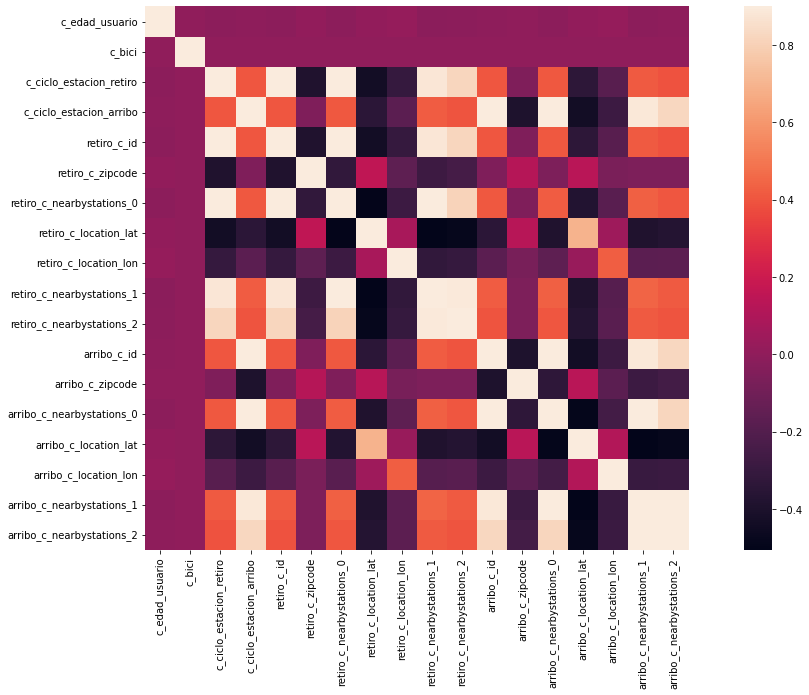

In [61]:
import matplotlib.pyplot as plt
import seaborn as sns
corrmat = Xs.corr()
plt.subplots(figsize=(20, 10))
sns.heatmap(corrmat, vmax=.9, square=True)

In [62]:
Xs.head(2)

,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
0,-1.727400,0.352883,1.784028,1.765204,1.784028,-0.264630,1.93719,-2.379020,-0.742732,1.887613,1.797020,1.765204,-0.284138,1.922246,-2.349528,-0.407250,1.878936,1.827227
1,-0.911638,-0.061994,-1.294104,0.612536,-1.294104,0.677573,-1.24446,0.668454,-0.034324,-1.231052,-1.124458,0.612536,-1.186803,-1.040178,0.938196,1.437366,-1.014855,-0.896797


# Modelado

In [49]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split

In [50]:
#Muestra para validar 
#X_train, X_test = train_test_split(dfTrips, test_size=0.3, random_state=249)

In [144]:
X_test = dfTrips.copy()

In [66]:
print(X_test.shape)
X_test.head(5)

(569666, 38)


,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day,retiro_c_id,retiro_t_name,retiro_t_address,retiro_c_zipcode,retiro_v_districtcode,retiro_v_districtname,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_v_stationtype,retiro_c_nearbystations_1,retiro_c_nearbystations_2,retiro_t_punto_geo,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo
1866465,M,27.0,5503966.0,23,2023-03-27,14:58:08.5250,14,2023-03-27,15:49:56.8480,Lunes,Lunes,tarde,23.0,REFORMA-PRAGA,ReformaPraga,6500.0,JUA,Juárez,15.0,19.425170,-99.171050,BIKE,16.0,22.0,"19.42517,-99.17105",14.0,REFORMA-RIO DE PLATA,ReformaRio de Plata,6500.0,CUA,Cuauhtémoc,13.0,19.424768,-99.173261,BIKE,21.0,22.0,"19.424768,-99.173261"
825110,F,27.0,4205951.0,25,2023-12-01,18:37:12.4510,231,2023-12-01,18:53:42.0040,Viernes,Viernes,noche,25.0,REFORMA-ESTOCOLMO,ReformaEstocolmo,6500.0,JUA,Juárez,17.0,19.427317,-99.166662,BIKE,18.0,0.0,"19.427317,-99.166662",231.0,NEWTON-ARISTOTELES,Newton-Aristoteles,11510.0,POL,Polanco,222.0,19.429770,-99.193490,BIKE,223.0,234.0,"19.42977,-99.19349"
103924,M,53.0,2452399.0,42,2023-06-02,07:58:23.2790,38,2023-06-02,08:00:29.6390,Viernes,Viernes,dia,42.0,SINALOA-VALLADOLID,SinaloaValladolid,6700.0,R-N,Roma Norte,39.0,19.420472,-99.168238,BIKE,47.0,48.0,"19.420472,-99.168238",38.0,COZUMEL-PUEBLA,CozumelPUEBLA,6700.0,R-N,Roma Norte,28.0,19.420801,-99.171407,BIKE,32.0,37.0,"19.420801,-99.171407"
1003227,F,25.0,7299688.0,12,2023-01-22,11:18:03.8420,20,2023-01-22,11:35:40.7110,Domingo,Domingo,dia,12.0,RIO LERMA-VILLALONGIN,Río LermaVillalongin,6500.0,1,Ampliación Granada,11.0,19.432313,-99.161597,BIKE,19.0,20.0,"19.432313,-99.161597",20.0,REFORMA-RIO TAMESIS,Reforma- Rio Tamesis,6500.0,CUA,Cuauhtémoc,12.0,19.430964,-99.160206,BIKE,19.0,27.0,"19.430964,-99.160206"
126905,M,21.0,4644167.0,252,2023-07-02,14:05:31.2630,190,2023-07-02,14:18:16.7710,Domingo,Domingo,tarde,252.0,VICTOR HUGO-SHAKESPEARE,Víctor Hugo-Shakespeare,11510.0,2,Anzures,249.0,19.427575,-99.177020,BIKE,251.0,253.0,"19.427575,-99.17702",190.0,E GDOR IGNACIO ESTEVA-MTRO JOSÉ VASCONCELOS,Gobernador Ignacio Esteva-Maestro José Vascon...,0.0,SMC,San Miguel Chapultepec,33.0,19.409569,-99.183833,ELECTRIC_BIKE,187.0,189.0,"19.409569,-99.183833"


In [51]:
# Obtener una muestra representativa de Xs
X_test_aux= X_test.filter(regex='c_')

    #filter(like='v_')

In [68]:
print(X_test_aux.shape)
X_test_aux.head(2)



(569666, 18)


,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
1866465,27.0,5503966.0,23,14,23.0,6500.0,15.0,19.425170,-99.171050,16.0,22.0,14.0,6500.0,13.0,19.424768,-99.173261,21.0,22.0
825110,27.0,4205951.0,25,231,25.0,6500.0,17.0,19.427317,-99.166662,18.0,0.0,231.0,11510.0,222.0,19.429770,-99.193490,223.0,234.0


In [52]:
# PCA
pca =PCA(n_components=3 ,random_state=1) # segunda opción para incrementar el porcentaje de varianza explicada
Xp = pd.DataFrame(pca.fit_transform(X_test_aux),columns=['d1','d2','d3'])
print(f'explained_variance_ratio_: {round(pca.explained_variance_ratio_.cumsum()[-1],4)*100}%')

explained_variance_ratio_: 100.0%


In [70]:
print(Xp.shape)

(569666, 3)


In [71]:
# T-SNE
tsne = TSNE(n_components=3,n_jobs=-1,random_state=1)
Xt = pd.DataFrame(tsne.fit_transform(X_test_aux),columns=['d1','d2','d3'])

In [53]:
print(Xt.shape)
print(X_test_aux.shape)

NameError: name 'Xt' is not defined

In [73]:
print(Xt.columns)
print('\n\n')
print(Xp.columns)

Index(['d1', 'd2', 'd3'], dtype='object')



Index(['d1', 'd2', 'd3'], dtype='object')


In [54]:
# Gráficas de modelos: PCA y T-SNE
print('PCA')
Xp.iplot(kind='scatter',mode='markers',x='d1',y='d2',z='d3',color='blue')
print('TSNE')
Xt.iplot(kind='scatter',mode='markers',x='d1',y='d2',color='blue')

PCA
TSNE


In [55]:
# Gráficas de modelos: PCA y T-SNE
print('PCA')
Xp.iplot(kind='scatter3d',mode='markers',x='d1',y='d2',z='d3',color='blue')
print('TSNE')
Xt.iplot(kind='scatter3d',mode='markers',x='d1',y='d2',z='d3',color='blue')

PCA


In [92]:
for col_selected in dfTrips.filter(regex='v_'):
    print(col_selected)

v_genero_usuario
v_day_week_retiro
v_day_week_arribo
v_moment_of_day
retiro_v_districtcode
retiro_v_districtname
retiro_v_stationtype
arribo_v_districtcode
arribo_v_districtname
arribo_v_stationtype


In [93]:
# Cambio de tipo de variables categóricas (string) para efectos de modelado
dfTrips['v_genero_usuario'] = dfTrips['v_genero_usuario'].astype('str')
dfTrips['v_moment_of_day'] = dfTrips['v_moment_of_day'].astype('str')

dfTrips['retiro_v_districtcode'] = dfTrips['retiro_v_districtcode'].astype('str')
dfTrips['retiro_v_districtname'] = dfTrips['retiro_v_districtname'].astype('str')


dfTrips['retiro_v_stationtype'] = dfTrips['retiro_v_stationtype'].astype('str')
dfTrips['arribo_v_districtcode'] = dfTrips['arribo_v_districtcode'].astype('str')


dfTrips['arribo_v_districtname'] = dfTrips['arribo_v_districtname'].astype('str')
dfTrips['arribo_v_stationtype'] = dfTrips['arribo_v_stationtype'].astype('str')

In [94]:
# Filtrado de las categóricas y graficado de los modelos
for col_selected in X_test_aux.filter(regex='v_'):
    print(col_selected)
    Xp=Xp.merge(X_test_aux[col_selected],right_index=True,left_index=True).copy()    
    Xt=Xt.merge(X_test_aux[col_selected],right_index=True,left_index=True).copy()

    print('PCA')
    Xp.iplot(kind='scatter',mode='markers',x='d1',y='d2',categories=col_selected) # Grafica de PCA para categóricas

    print('TSNE')
    Xt.iplot(kind='scatter',mode='markers',x='d1',y='d2',categories=col_selected)

In [125]:
# Dependencias requeridas para modelado
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

## K-means

**Inercia y silueta**

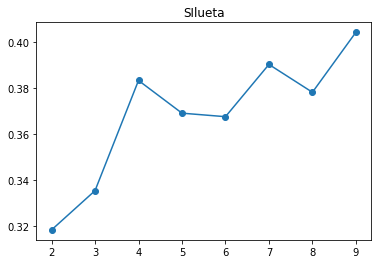

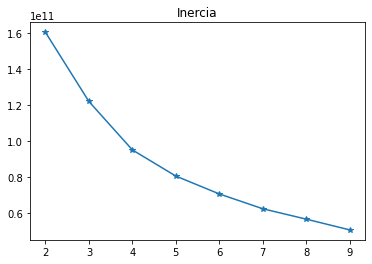

In [96]:
l = []
m= []
for k in range(2,10):
    km = KMeans(n_clusters=k,max_iter=100)
    km.fit(X_test_aux)
    l.append((k,km.inertia_))
    m.append((k,silhouette_score(X_test_aux,km.predict(X_test_aux))))
inercia = pd.DataFrame(l,columns=['k','inercia'])
silueta = pd.DataFrame(m,columns=['m','silueta'])

plot1 = plt.figure(1)
plt.title('SIlueta')
plt.plot(silueta['m'],silueta['silueta'],marker='o')
plot2 = plt.figure(2)
plt.title('Inercia')
plt.plot(inercia['k'],inercia['inercia'],marker='*')
plt.show()

**Clustering**

In [97]:
data.head(1)

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day,retiro_c_id,retiro_t_name,retiro_t_address,retiro_c_zipcode,retiro_v_districtcode,retiro_v_districtname,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_v_stationtype,retiro_c_nearbystations_1,retiro_c_nearbystations_2,retiro_t_punto_geo,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo
0,M,32.0,7608.0,18,2021-01-01,07:05:04,143,2021-01-01,07:13:25,Viernes,Viernes,dia,18.0,REFORMA-RIO RHIN,ReformaRío Rhin,6500.0,CUA,Cuauhtémoc,17.0,19.42888,-99.164176,"BIKE,TPV",25.0,0.0,"19.42888,-99.164176",143.0,CÓRDOBA-SAN LUIS POTOSÍ,Córdoba-San Luis Potosí,0.0,R-N,Roma Norte,141.0,19.414303,-99.157542,BIKE,144.0,147.0,"19.414303,-99.157542"


In [98]:
print(Xp.shape)
print(Xt.shape)
#print(data.shape)
print(X_test_aux.shape)

(8408, 3)
(8408, 3)
(8408, 18)


In [99]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X = X_test_aux.filter(regex='c_')
data = X_test_aux.copy()
Xs = pd.DataFrame(sc.fit_transform(X),columns=X.columns)
Xs=Xs.replace(np.nan, 0)
print(Xs.shape)
Xs.head()

(8408, 18)


,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
0,-0.798037,-0.100545,-0.892091,-0.280463,-0.892091,0.692490,-0.797131,-0.152199,-0.007999,-0.735777,-0.671963,-0.280463,-1.160294,-0.222765,-0.171635,0.472844,-0.205908,-0.120041
1,-0.583876,-0.761766,1.327376,-0.407959,1.327376,-0.029519,1.415345,-1.652228,-0.987027,1.391213,1.333028,-0.407959,-1.160294,-0.329411,0.201650,0.570652,-0.287550,-0.245889
2,0.379852,0.945356,1.453990,1.309477,1.453990,0.031154,1.589615,-1.824281,-1.273111,1.561669,1.686850,1.309477,-0.023028,1.430252,-1.598327,-1.238841,1.412092,1.362159
3,-0.905118,1.114995,-1.167663,-0.415458,-1.167663,0.813836,-1.160826,0.422045,-0.139130,-1.017400,-0.935595,-0.415458,-1.160294,-0.337028,0.337713,0.930823,-0.317238,-0.259872
4,-0.690957,0.857028,1.118835,1.129484,1.118835,-0.241875,1.112266,-1.336998,0.539622,1.220758,1.173462,1.129484,-0.234541,1.125548,-1.347758,0.497054,1.226541,1.194363


In [100]:
k = 4
XsArr = np.array(Xs)

km = KMeans(n_clusters=k,max_iter=100,random_state=1)
km.fit(XsArr)

X_test["cl_kme"] = Xp['cl_kme']= Xt['cl_kme']= km.predict(Xs.filter(regex='c_')).astype(str)

centroides = km.cluster_centers_
etiquetas = km.labels_

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/sklearn/base.py:438: UserWarning:

X has feature names, but KMeans was fitted without feature names



### Visualización en $\mathbb{R}^3$

In [101]:
col_selected='cl_kme'
print('PCA')
Xp.iplot(kind='scatter3d',mode='markers',x='d1',y='d2',z='d3',categories=col_selected, title= "PCA")
#print('MDS')
print('TSNE')
Xt.iplot(kind='scatter3d',mode='markers',x='d1',y='d2',z='d3',categories=col_selected,title= "TSNE")

PCA


TSNE


In [102]:
X_test.filter(regex="v_").columns.tolist()

['v_genero_usuario',
 'v_day_week_retiro',
 'v_day_week_arribo',
 'v_moment_of_day',
 'retiro_v_districtcode',
 'retiro_v_districtname',
 'retiro_v_stationtype',
 'arribo_v_districtcode',
 'arribo_v_districtname',
 'arribo_v_stationtype']

In [103]:
##Perfilamiento

In [104]:
X_test

,v_genero_usuario,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,d_fecha_retiro,d_hora_retiro,c_ciclo_estacion_arribo,d_fecha_arribo,d_hora_arribo,v_day_week_retiro,v_day_week_arribo,v_moment_of_day,retiro_c_id,retiro_t_name,retiro_t_address,retiro_c_zipcode,retiro_v_districtcode,retiro_v_districtname,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_v_stationtype,retiro_c_nearbystations_1,retiro_c_nearbystations_2,retiro_t_punto_geo,arribo_c_id,arribo_t_name,arribo_t_address,arribo_c_zipcode,arribo_v_districtcode,arribo_v_districtname,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_v_stationtype,arribo_c_nearbystations_1,arribo_c_nearbystations_2,arribo_t_punto_geo,cl_kme
251033,M,28.0,9313.0,69,2021-01-02,18:04:01,151,2021-01-02,18:10:29,Sabado,Sabado,noche,69.0,MICHOACAN-AMSTERDAM,MichoacánAmsterdam,6100.0,HIP,Hipódromo,70.0,19.410733,-99.168111,BIKE,76.0,77.0,"19.410733,-99.168111",151.0,CAMPECHE-TONALÁ,Campeche-Tonalá,0.0,ROM,Roma Sur,145.0,19.410529,-99.160873,BIKE,147.0,155.0,"19.410529,-99.160873",3
364006,M,30.0,7711.0,367,2021-02-14,17:00:38,134,2021-02-14,17:23:06,Domingo,Domingo,tarde,367.0,BOSTON -AUGUSTO RODÍN,Boston -Augusto Rodín,3720.0,NBU,Noche Buena,362.0,19.379460,-99.181632,BIKE,363.0,366.0,"19.37946,-99.181632",134.0,ÁLVARO OBREGÓN-ORIZABA,Álvaro Obregón-Orizaba,0.0,R-N,Roma Norte,131.0,19.418304,-99.159560,"BIKE,TPV",136.0,137.0,"19.418304,-99.15956",2
191205,F,39.0,11847.0,384,2021-01-23,15:21:30,363,2021-01-23,15:40:24,Sabado,Sabado,tarde,384.0,EMPRESA-POUSSIN,Empresa-Poussin,3920.0,INM,Insurgentes Mixcoac,385.0,19.375873,-99.185583,BIKE,386.0,417.0,"19.375873,-99.185583",363.0,HOLBEIN-PAULO UCELLO,Holbein-Paulo Ucello,3710.0,CDD,Ciudad de los Deportes,362.0,19.380813,-99.183851,BIKE,365.0,367.0,"19.380813,-99.183851",1
90771,M,27.0,12258.0,32,2021-01-13,20:52:44,133,2021-01-13,21:02:42,Miercoles,Miercoles,noche,32.0,LONDRES-SEVILLA,LondresSevilla,6500.0,JUA,Juárez,22.0,19.422705,-99.169922,BIKE,38.0,39.0,"19.422705,-99.169922",133.0,COLIMA-MORELIA,Colima-Morelia,0.0,R-N,Roma Norte,130.0,19.421138,-99.154725,BIKE,132.0,135.0,"19.421138,-99.154725",3
556736,M,29.0,11633.0,339,2021-03-03,07:37:23,339,2021-03-03,07:55:58,Miercoles,Miercoles,dia,339.0,ENRIQUE RÉBSAMEN-AVENIDA EUGENIA,Enrique Rébsamen-Avenida Eugenia,3020.0,NAR,Narvarte Poniente,322.0,19.386032,-99.160548,BIKE,340.0,343.0,"19.386032,-99.160548",339.0,ENRIQUE RÉBSAMEN-AVENIDA EUGENIA,Enrique Rébsamen-Avenida Eugenia,3020.0,NAR,Narvarte Poniente,322.0,19.386032,-99.160548,BIKE,340.0,343.0,"19.386032,-99.160548",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89168,M,38.0,12148.0,212,2021-01-13,19:05:56,162,2021-01-13,20:00:06,Miercoles,Miercoles,noche,212.0,HEGEL-HORACIO,Hegel-Horacio,11510.0,POL,Polanco,211.0,19.433567,-99.188096,"BIKE,TPV",218.0,224.0,"19.433567,-99.188096",162.0,TEHUANTEPEC-MEDELLÍN,Tehuantepec-Medellín,0.0,ROM,Roma Sur,161.0,19.404907,-99.162485,BIKE,165.0,0.0,"19.404907,-99.162485",2
125680,M,38.0,12244.0,283,2021-01-19,13:37:04,348,2021-01-19,13:50:20,Martes,Martes,tarde,283.0,AV. COYOACÁN-RAFAEL DONDE,Av. Coyoacán-Rafael Donde,3103.0,1,Ampliación Granada,279.0,19.398270,-99.167383,BIKE,292.0,293.0,"19.39827,-99.167383",348.0,INDIANA-AVENIDA SAN ANTONIO,Indiana-Avenida San Antonio,3710.0,CDD,Ciudad de los Deportes,347.0,19.385365,-99.178216,BIKE,349.0,350.0,"19.385365,-99.178216",1
291249,M,31.0,10166.0,93,2021-05-02,17:57:20,106,2021-05-02,18:07:20,Domingo,Domingo,tarde,93.0,PALMA NORTE-REPUBLICA DE CUBA,Palma Norte-Republica de Cuba,6500.0,CEN,Centro,90.0,19.436741,-99.134811,BIKE,91.0,92.0,"19.436741,-99.134811",106.0,SAN JERONIMO-JOSE MARIA PINO SUAREZ,San Jerónimo-José María Pino Suarez,6500.0,CEN,Centro,100.0,19.426490,-99.133537,BIKE,101.0,105.0,"19.42649,-99.133537",0
360182,M,22.0,11515.0,326,2021-02-13,15:26:41,381,2021-02-13,15:34:38,Sabado,Sa

In [105]:
cl = 'cl_kme'
X_test[X_test.filter(regex="c_").columns.tolist() + [cl]].groupby('cl_kme').mean()

,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
cl_kme,,,,,,,,,,,,,,,,,,
0,35.970970,9343.128342,80.060351,66.891138,80.060351,4758.082506,72.003438,19.422596,-99.162737,70.953400,69.822383,66.891138,6469.602750,60.907945,19.423809,-99.163892,62.153934,61.264706
1,35.202292,9790.457307,348.281948,366.985673,348.281948,3209.161605,336.292264,19.388041,-99.172245,345.575931,344.462464,366.985673,3036.264756,355.777077,19.386494,-99.171925,364.158166,360.557593
2,34.934975,9530.517045,301.221591,132.941288,301.221591,3837.805556,280.422980,19.418248,-99.177849,274.174242,271.288510,132.941288,5077.931187,118.529672,19.423978,-99.171404,120.836490,119.630682
3,35.412028,9634.659488,118.959772,226.715969,118.959772,3234.527834,103.045104,19.420206,-99.164251,101.860219,100.847623,226.715969,628.261682,201.950427,19.417002,-99.164733,194.903698,190.387241


In [ ]:
X_test[X_test.filter(regex="c_").columns.tolist()].mean().to_frame().T

,c_edad_usuario,c_bici,c_ciclo_estacion_retiro,c_ciclo_estacion_arribo,retiro_c_id,retiro_c_zipcode,retiro_c_nearbystations_0,retiro_c_location_lat,retiro_c_location_lon,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_id,arribo_c_zipcode,arribo_c_nearbystations_0,arribo_c_location_lat,arribo_c_location_lon,arribo_c_nearbystations_1,arribo_c_nearbystations_2
0,35.452664,9556.600143,188.77795,188.396527,188.77795,3817.305423,175.204448,19.413906,-99.168001,175.280209,173.856922,188.396527,3785.120956,174.243459,19.414104,-99.167221,174.742864,172.1696


In [107]:
pd.options.plotting.backend = 'matplotlib'

<AxesSubplot:title={'center':'Distribución'}, ylabel='cl_kme'>

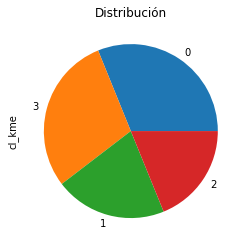

In [108]:
X_test[cl].value_counts(1).plot(kind="pie",title="Distribución")



In [109]:
X_test.filter(regex="cl_kme").columns.values

array(['cl_kme'], dtype=object)

In [110]:
dc_agg = {'c_edad_usuario': ['mean'],
          'retiro_c_nearbystations_0': ['mean'],
          'retiro_c_nearbystations_1': ['mean'],
          'retiro_c_nearbystations_2': ['mean'],
          'arribo_c_nearbystations_0': ['mean'],
          'arribo_c_nearbystations_1': ['mean'],
          'arribo_c_nearbystations_2': ['mean']}

In [111]:
X_test['aux_cte']=1

avg_general=X_test[X_test.filter(regex="c_").columns.tolist()+['aux_cte']].groupby('aux_cte').agg(
dc_agg
)
avg_general.index=['avg_general']
avg_general

,c_edad_usuario,retiro_c_nearbystations_0,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_nearbystations_0,arribo_c_nearbystations_1,arribo_c_nearbystations_2
,mean,mean,mean,mean,mean,mean,mean
avg_general,35.452664,175.204448,175.280209,173.856922,174.243459,174.742864,172.1696


In [112]:
cl = 'cl_kme'
pd.concat([X_test[X_test.filter(regex="c_").columns.tolist()+[cl]].groupby(cl).agg(
dc_agg
)],axis=0).style.background_gradient(axis=0)

,c_edad_usuario,retiro_c_nearbystations_0,retiro_c_nearbystations_1,retiro_c_nearbystations_2,arribo_c_nearbystations_0,arribo_c_nearbystations_1,arribo_c_nearbystations_2
,mean,mean,mean,mean,mean,mean,mean
cl_kme,,,,,,,
0,35.970970,72.003438,70.953400,69.822383,60.907945,62.153934,61.264706
1,35.202292,336.292264,345.575931,344.462464,355.777077,364.158166,360.557593
2,34.934975,280.422980,274.174242,271.288510,118.529672,120.836490,119.630682
3,35.412028,103.045104,101.860219,100.847623,201.950427,194.903698,190.387241


In [113]:
X_test.filter(regex="v_").columns.tolist()

['v_genero_usuario',
 'v_day_week_retiro',
 'v_day_week_arribo',
 'v_moment_of_day',
 'retiro_v_districtcode',
 'retiro_v_districtname',
 'retiro_v_stationtype',
 'arribo_v_districtcode',
 'arribo_v_districtname',
 'arribo_v_stationtype']

In [114]:
X_test.filter(regex="v_").columns.tolist()

['v_genero_usuario',
 'v_day_week_retiro',
 'v_day_week_arribo',
 'v_moment_of_day',
 'retiro_v_districtcode',
 'retiro_v_districtname',
 'retiro_v_stationtype',
 'arribo_v_districtcode',
 'arribo_v_districtname',
 'arribo_v_stationtype']

In [115]:

from IPython.core.display import display


def discretes_profiling(v):
    piv = X_test.pivot_table(index=cl,columns=v,aggfunc='count',values='aux_cte')
    piv['t'] = piv.sum(axis=1)
    for c in piv.columns:
        piv[c]/=piv['t']
    display(piv.style.background_gradient(axis=0))
    return piv

In [116]:
for v in ["v_moment_of_day"]:
    discretes_profiling(v)

v_moment_of_day,dia,madrugada,noche,tarde,t
cl_kme,,,,,
0,0.372422,0.155844,0.142857,0.328877,1.000000
1,0.397708,0.159885,0.161032,0.281375,1.000000
2,0.424874,0.148359,0.158460,0.268308,1.000000
3,0.371394,0.155628,0.168631,0.304348,1.000000


In [117]:
for v in X_test.filter(regex="v_").columns.tolist():
    discretes_profiling(v)

v_genero_usuario,F,M,otro,t
cl_kme,,,,
0,0.264324,0.618793,0.116883,1.000000
1,0.279083,0.604011,0.116905,1.000000
2,0.272096,0.606692,0.121212,1.000000
3,0.286469,0.585941,0.127590,1.000000


v_day_week_retiro,Domingo,Jueves,Lunes,Martes,Miercoles,Sabado,Viernes,otro,t
cl_kme,,,,,,,,,
0,0.120321,0.145149,0.116883,0.141711,0.185256,0.139419,0.151261,nan,1.000000
1,0.103725,0.146132,0.126074,0.160458,0.182808,0.136390,0.144413,nan,1.000000
2,0.119318,0.142045,0.129419,0.154672,0.200126,0.119318,0.134470,0.000631,1.000000
3,0.119464,0.148314,0.121902,0.159691,0.167412,0.131247,0.151971,nan,1.000000


v_day_week_arribo,Domingo,Jueves,Lunes,Martes,Miercoles,Sabado,Viernes,t
cl_kme,,,,,,,,
0,0.119939,0.144385,0.116119,0.142857,0.185256,0.139801,0.151642,1.000000
1,0.103725,0.146132,0.125501,0.160458,0.182235,0.136390,0.145559,1.000000
2,0.118687,0.141414,0.129419,0.155303,0.200758,0.118687,0.135732,1.000000
3,0.120276,0.147095,0.121902,0.159285,0.168224,0.130028,0.153190,1.000000


v_moment_of_day,dia,madrugada,noche,tarde,t
cl_kme,,,,,
0,0.372422,0.155844,0.142857,0.328877,1.000000
1,0.397708,0.159885,0.161032,0.281375,1.000000
2,0.424874,0.148359,0.158460,0.268308,1.000000
3,0.371394,0.155628,0.168631,0.304348,1.000000


retiro_v_districtcode,1,2,ACA,ACT,AME,AMG,AMN,ANH,ANI,BUE,CDD,CEN,CHA,CON,CUA,CUP,DOC,DVC,DVN,DVS,ESC,EXI,GPM,GRA,H-C,HIP,INM,IRR,ISB,JUA,LCH,LCI,LEV,LMV,MDR,NAP,NAR,NBU,POL,PON,R-N,REE,ROM,S-R,SCA,SMC,SMN,SPP,TAB,TLA,XOC,t
cl_kme,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.173797,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.114973,0.000382,0.071047,0.107716,nan,0.008021,nan,nan,nan,0.006112,nan,nan,nan,0.011459,0.099312,nan,nan,nan,0.171123,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.162720,nan,0.030558,0.025210,nan,nan,nan,nan,0.017571,nan,nan,1.000000
1,0.155301,0.007450,0.016619,0.022350,0.005731,0.000573,0.018338,0.001146,0.004585,0.007450,0.012607,nan,0.005731,nan,0.001146,0.003438,nan,0.058453,0.092264,0.115759,0.012034,0.005158,0.016619,0.007450,0.000573,0.005731,0.057880,0.001146,0.007450,0.001719,0.001146,0.002865,0.016046,0.005158,0.001146,0.050430,0.077364,0.004585,0.029799,0.010315,0.003438,0.005158,0.008596,0.002865,0.035530,0.004585,0.013181,0.038968,0.001719,0.029799,0.012607,1.000000
2,0.171717,0.045455,0.001894,0.006944,0.014520,0.003157,0.006944,0.001894,0.026515,0.061869,0.009470,nan,0.045455,0.001263,0.017677,0.006313,nan,0.013258,0.054293,0.028409,0.014520,0.001894,0.004419,0.035354,0.006944,0.003157,0.015783,0.005051,0.004419,0.013258,0.006313,0.005682,0.002525,0.009470,0.004419,0.032197,0.047980,0.001894,0.182449,0.001894,nan,0.000631,nan,0.012626,0.003788,0.025884,0.003157,0.018939,0.006944,0.010732,0.000631,1.000000
3,0.151158,0.002032,nan,nan,nan,nan,nan,nan,nan,0.011784,nan,0.084112,0.004063,0.045104,0.053230,nan,0.006501,nan,0.000406,nan,0.030069,nan,nan,0.000813,0.014628,0.089395,nan,nan,nan,0.101178,nan,nan,nan,nan,nan,nan,0.000813,nan,0.011784,nan,0.212109,nan,0.092239,0.043478,nan,0.028037,nan,nan,0.017066,nan,nan,1.000000


retiro_v_districtname,Acacias,Actipan,Ampliación Granada,Ampliación Nápoles,Anzures,Anáhuac Dos Lagos,Anáhuac I,Anáhuac Mariano Escobedo,Bosque de Chapultepec,Buenavista,Centro,Ciudad de los Deportes,Condesa,Cuauhtémoc,Cuauhtémoc Pensil,Del Valle Centro,Del Valle Norte,Del Valle Sur,Doctores,Escandón,Extremadura Insurgentes,General Pedro Maria Anaya,Granada,Hipódromo,Hipódromo Condesa,Insurgentes Mixcoac,Insurgentes San Borja,Irrigación,Juárez,Letran Valle,Lomas Virreyes,Lomas de Chapultepec Sección III,Lomas de Chapultepec Sección V,Molino del Rey,Narvarte Poniente,Noche Buena,Nápoles,Polanco,Portales Norte,Residencial Emperadores,Roma Norte,Roma Sur,San Miguel Chapultepec,San Pedro de los Pinos,San Rafael,Santa Cruz Atoyac,Santa María Nonoalco,Tabacalera,Tlacoquemecatl,Xoco,t
cl_kme,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,nan,nan,0.173797,nan,nan,nan,nan,nan,0.000382,nan,0.114973,nan,0.071047,0.107716,nan,nan,nan,nan,0.008021,0.006112,nan,nan,nan,0.099312,0.011459,nan,nan,nan,0.171123,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.162720,0.030558,nan,nan,0.025210,nan,nan,0.017571,nan,nan,1.000000
1,0.016619,0.022350,0.155874,0.018338,0.007450,0.001146,0.004585,0.005731,0.005731,0.007450,nan,0.012607,nan,0.001146,0.003438,0.058453,0.092264,0.115759,nan,0.012034,0.005158,0.016619,0.007450,0.005731,0.000573,0.057880,0.007450,0.001146,0.001719,0.016046,0.005158,0.002865,0.001146,0.001146,0.077364,0.004585,0.050430,0.029799,0.010315,0.005158,0.003438,0.008596,0.004585,0.038968,0.002865,0.035530,0.013181,0.001719,0.029799,0.012607,1.000000
2,0.001894,0.006944,0.174874,0.006944,0.045455,0.001894,0.026515,0.014520,0.045455,0.061869,nan,0.009470,0.001263,0.017677,0.006313,0.013258,0.054293,0.028409,nan,0.014520,0.001894,0.004419,0.035354,0.003157,0.006944,0.015783,0.004419,0.005051,0.013258,0.002525,0.009470,0.005682,0.006313,0.004419,0.047980,0.001894,0.032197,0.182449,0.001894,0.000631,nan,nan,0.025884,0.018939,0.012626,0.003788,0.003157,0.006944,0.010732,0.000631,1.000000
3,nan,nan,0.151158,nan,0.002032,nan,nan,nan,0.004063,0.011784,0.084112,nan,0.045104,0.053230,nan,nan,0.000406,nan,0.006501,0.030069,nan,nan,0.000813,0.089395,0.014628,nan,nan,nan,0.101178,nan,nan,nan,nan,nan,0.000813,nan,nan,0.011784,nan,nan,0.212109,0.092239,0.028037,nan,0.043478,nan,nan,0.017066,nan,nan,1.000000


retiro_v_stationtype,BIKE,"BIKE,TPV",ELECTRIC_BIKE,t
cl_kme,,,,
0,0.629106,0.359817,0.011077,1.000000
1,0.716332,0.209169,0.074499,1.000000
2,0.700126,0.246843,0.053030,1.000000
3,0.647298,0.297034,0.055668,1.000000


arribo_v_districtcode,1,2,ACA,ACT,AME,AMG,AMN,ANH,ANI,BUE,CDD,CEN,CHA,CON,CUA,CUP,DOC,DVC,DVN,DVS,ESC,EXI,GPM,GRA,H-C,HIP,INM,IRR,ISB,JUA,LCH,LCI,LEV,LMV,MDR,NAP,NAR,NBU,POL,PON,R-N,REE,ROM,S-R,SCA,SMC,SMN,SPP,TAB,TLA,XOC,t
cl_kme,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.166539,0.005348,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.150115,0.014133,0.076012,0.120321,nan,0.010313,nan,nan,nan,nan,nan,nan,0.002292,0.016425,0.104278,nan,nan,nan,0.173033,nan,nan,nan,nan,nan,nan,nan,nan,0.022154,nan,0.114973,nan,nan,0.013751,nan,nan,nan,nan,0.010313,nan,nan,1.000000
1,0.155874,0.013181,0.015473,0.019484,0.010888,0.004011,0.016619,0.001146,0.024069,0.004011,0.014327,nan,nan,nan,0.000573,0.002865,nan,0.064183,0.089971,0.116905,0.001719,0.006304,0.021777,0.007450,nan,0.000573,0.055014,0.001146,0.009742,0.000573,0.001719,0.004585,0.018338,0.009742,0.002865,0.060172,0.073352,0.006304,0.000573,0.007450,nan,0.006304,0.001146,nan,0.042407,0.001146,0.012034,0.038968,nan,0.044126,0.010888,1.000000
2,0.176768,0.015152,nan,nan,nan,nan,nan,nan,nan,0.011364,nan,0.065025,0.015783,0.036616,0.056187,nan,0.007576,nan,0.000631,nan,0.029040,nan,nan,0.015152,0.010732,0.073232,nan,0.000631,nan,0.105429,nan,nan,nan,nan,nan,nan,0.001894,nan,0.159091,nan,0.123106,nan,0.042929,0.027146,nan,0.017045,nan,nan,0.009470,nan,nan,1.000000
3,0.169443,0.012190,0.000406,0.001219,0.006095,0.000406,0.003657,0.002032,0.007314,0.070703,0.003251,0.021536,0.001625,0.006908,0.008533,0.002844,nan,0.006501,0.027631,0.005689,0.042666,0.001219,0.000813,0.006095,0.011784,0.035758,0.006095,0.001219,0.001219,0.024380,0.000813,nan,0.002032,0.002032,0.000813,0.019098,0.044291,0.001625,0.012190,0.000813,0.221455,0.000406,0.094271,0.049167,0.002844,0.029663,0.001219,0.006095,0.019098,0.002438,0.000406,1.000000


arribo_v_districtname,Acacias,Actipan,Ampliación Granada,Ampliación Nápoles,Anzures,Anáhuac Dos Lagos,Anáhuac I,Anáhuac Mariano Escobedo,Bosque de Chapultepec,Buenavista,Centro,Ciudad de los Deportes,Condesa,Cuauhtémoc,Cuauhtémoc Pensil,Del Valle Centro,Del Valle Norte,Del Valle Sur,Doctores,Escandón,Extremadura Insurgentes,General Pedro Maria Anaya,Granada,Hipódromo,Hipódromo Condesa,Insurgentes Mixcoac,Insurgentes San Borja,Irrigación,Juárez,Letran Valle,Lomas Virreyes,Lomas de Chapultepec Sección III,Lomas de Chapultepec Sección V,Molino del Rey,Narvarte Poniente,Noche Buena,Nápoles,Polanco,Portales Norte,Residencial Emperadores,Roma Norte,Roma Sur,San Miguel Chapultepec,San Pedro de los Pinos,San Rafael,Santa Cruz Atoyac,Santa María Nonoalco,Tabacalera,Tlacoquemecatl,Xoco,t
cl_kme,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,nan,nan,0.166539,nan,0.005348,nan,nan,nan,0.014133,nan,0.150115,nan,0.076012,0.120321,nan,nan,nan,nan,0.010313,nan,nan,nan,0.002292,0.104278,0.016425,nan,nan,nan,0.173033,nan,nan,nan,nan,nan,nan,nan,nan,0.022154,nan,nan,0.114973,nan,nan,nan,0.013751,nan,nan,0.010313,nan,nan,1.000000
1,0.015473,0.019484,0.159885,0.016619,0.013181,0.001146,0.024069,0.010888,nan,0.004011,nan,0.014327,nan,0.000573,0.002865,0.064183,0.089971,0.116905,nan,0.001719,0.006304,0.021777,0.007450,0.000573,nan,0.055014,0.009742,0.001146,0.000573,0.018338,0.009742,0.004585,0.001719,0.002865,0.073352,0.006304,0.060172,0.000573,0.007450,0.006304,nan,0.001146,0.001146,0.038968,nan,0.042407,0.012034,nan,0.044126,0.010888,1.000000
2,nan,nan,0.176768,nan,0.015152,nan,nan,nan,0.015783,0.011364,0.065025,nan,0.036616,0.056187,nan,nan,0.000631,nan,0.007576,0.029040,nan,nan,0.015152,0.073232,0.010732,nan,nan,0.000631,0.105429,nan,nan,nan,nan,nan,0.001894,nan,nan,0.159091,nan,nan,0.123106,0.042929,0.017045,nan,0.027146,nan,nan,0.009470,nan,nan,1.000000
3,0.000406,0.001219,0.169850,0.003657,0.012190,0.002032,0.007314,0.006095,0.001625,0.070703,0.021536,0.003251,0.006908,0.008533,0.002844,0.006501,0.027631,0.005689,nan,0.042666,0.001219,0.000813,0.006095,0.035758,0.011784,0.006095,0.001219,0.001219,0.024380,0.002032,0.002032,nan,0.000813,0.000813,0.044291,0.001625,0.019098,0.012190,0.000813,0.000406,0.221455,0.094271,0.029663,0.006095,0.049167,0.002844,0.001219,0.019098,0.002438,0.000406,1.000000


arribo_v_stationtype,BIKE,"BIKE,TPV",ELECTRIC_BIKE,t
cl_kme,,,,
0,0.627578,0.361345,0.011077,1.000000
1,0.731232,0.194269,0.074499,1.000000
2,0.625000,0.321970,0.053030,1.000000
3,0.707030,0.237302,0.055668,1.000000
